# Deep Convolutional Generative Adversarial Network (DCGAN) for Bored Apes

Would you buy a piece of digital art, a 631 x 631 pixels image, for $200,000? This is actually the least money you can pay to purchase an NFT from the Bored Ape Yach Club collection (you can think of NFTs as a way to ensure uniqueness and ownership of digital art). It contains 10,000 digital images of cartoon apes. The project was launched in April 2021 and has been one of the most successful NFT projects.

In this notebook, we use Deep Convolutional Generative Adversarial Networks (DCGAN) to generate new Bored Ape Yacht Club NFTs. Generative Adversarial Network, in general, is a Deep Learning Architecture wherein two agents, a Generator and a Discriminator, compete against each other. The Generator attempts to create fake images that look like the real ones. The Discriminator's job is to discern between the real and fake images. Based on the Discriminator's feedback, the Generator attempts to improve. The training goes for many epochs. Ideally, until the Discriminator cannot tell the difference between the real and fake images, the process can be visualized as follows:




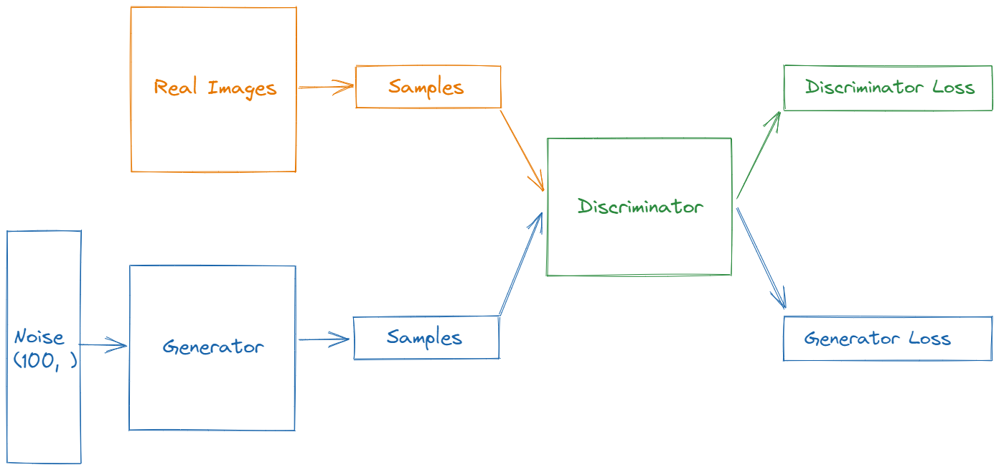

In [ ]:
from IPython.display import display, Image
display(Image(filename='/content/gan_arch.png'))


In the sections below, we will dive into the process in more detail. The structure of the Notebook is following:
1. Preparing Data
2. Creating the Generator & Discriminator models
3. Defining the Loss & Optimization functions
4. Describing the training process
5. Evaluating results and images
  - [Link](https://drive.google.com/drive/folders/1R8Vzbgdmmx3-rPedEVek0qqgEuCJltbk) to our gallery of apes
6. Final Discussion
7. Appendix A: Neglected Apes & Failed Model

We also want to acknowledge that we reuse some code from Tensorflow's GAN Notebook, which you can find [here](https://www.tensorflow.org/tutorials/generative/dcgan).

### Import Libraries

In [ ]:
import tensorflow as tf

In [ ]:
tf.__version__

'2.7.0'

In [ ]:
# To generate GIFs
!pip install imageio
!pip install git+https://github.com/tensorflow/docs

  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-7ty964e1
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-7ty964e1
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=159918 sha256=49bd0ff1ae1c1d121043b0ee1a61639b7d00504aa23aeed47f06987f10873310
  Stored in directory: /tmp/pip-ephem-wheel-cache-p5dbd869/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs


In [ ]:
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time
import pickle

from IPython import display

### Dataset

We downloaded the Bored Apes NFT dataset from [this Kaggle Dataset](https://www.kaggle.com/stanleyjzheng/bored-apes-yacht-club/version/2). One of the images was corrupt, so we manually removed it, leaving us with 9999 Bored Apes.

We processed the images by converting them from BRGA to RGBA image format, resizing them to 64x64, and saving them in a pickle file from which we can quickly reload the data. 

While we would love to generate the original 631x631 pixel size fake Bored Apes, our computational availability wouldn't allow that. Hence, we settled on a 64x64 size which would speed up our training.

In [ ]:
# run this only if the Pickle file isn't already created
import cv2

depth = 4
image_size_y = 64
image_size_x = 64

image_data = []

# for each image in the folder:
for image in glob.glob('test_dataset/*.jpg'):
    # read the image
    img = cv2.imread(image, cv2.IMREAD_UNCHANGED)
    #img = cv2.imread(image)
    # convert it from BGRA to RGBA for matplolib compatibility
    # https://www.bogotobogo.com/python/OpenCV_Python/python_opencv3_matplotlib_rgb_brg_image_load_display_save.php
    b,g,r,a= cv2.split(img)       # get b,g,r,a
    img = cv2.merge([r,g,b,a])     # switch it to rgba

    # resize to 64x64
    img = cv2.resize(img, dsize=(image_size_y, image_size_x), interpolation=cv2.INTER_AREA)
    image_data.append(img)

image_data = np.array(image_data, dtype='float32')
    
#dump the data into a pickle file
with open('bored_apes_64_4_test.pkl', 'wb') as file:
    dataset = image_data
    pickle.dump(dataset, file)
#image_data = np.array(image_data)   

We are going to use personal Google Drive to store the models, images, gifs, and pre-trained dataset. if you'd like to use any of it, you can find it in our Google Drive folder [here](https://drive.google.com/drive/folders/11m_cRZyVbvYXOnIAlJtYlppWWj89JPMI?usp=sharing)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
file = open('/content/drive/MyDrive/datasets/bored_apes_64_4.pkl', 'rb')
image_data = pickle.load(file)
file.close()

In [ ]:
# Define constants
depth = 4
image_size_y = 64
image_size_x = 64
BUFFER_SIZE = 9999
BATCH_SIZE = 256

# reshape the dataset to (9999, 64, 64, 4)
train_images = image_data.reshape(len(image_data), image_size_x, image_size_y, depth).astype('float32')
# rescale the pixel values to [-1, 1]
train_images = (train_images - 127.5) / 127.5 
# convert to valid tensorflow Dataset
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

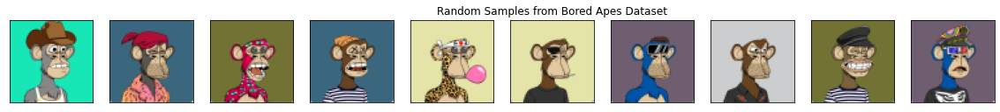

In [ ]:
def plot_images(n, images, random=False, title=None):
    '''
    Plots n images from the dataset
    '''
    # turn the images from [-1, 1] to [0, 1]
    images = images*127.5 + 127.5
    images = images / 255.0

    plt.figure(figsize=(20, 10))
    
    for i in range(n):
        ax = plt.subplot(2, n, i + 1)
        if random:
          # choose a random index
          image_index = np.random.choice(images.shape[0], 1, replace=False)  
          # plot the randomly chosen image 
          plt.imshow(images[image_index][0, :, :, :])
        else:
          plt.imshow(images[i])

        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        if i == n//2:
          if title is not None:
            plt.title(title)   
            
    plt.show()
    
plot_images(10, train_images, random=True, title="Random Samples from Bored Apes Dataset")

Finally, after the image processing, our Bored Apes to 'excited' to stand in-between the Generator vs. Discriminator battle.

## Model Architecture

In this section, we will describe in-detail the architectures of Generator and Discriminator.

Both the generator and discriminator are defined using the [Keras Sequential API](https://www.tensorflow.org/guide/keras#sequential_model).

### The Generator

As mentioned above, the Generator's job is to create fake images that look like the real ones. It takes an array of random noise as input and then, using Convolutional and Upsampling layers, it creates an image. In particular, we use `tf.keras.layers.Conv2DTranspose` (upsampling) layers to produce an image of the desired size from random noise. It takes a few layers to scale up to the desired size. 

We first scale up our random noise of size (100,) to the desired starting image size with a Dense layer. Next, we apply several blocks of Convolution&Upsampling -> BatchNormalization -> LeakyReLU. Convolutional layers help the Generator learn patterns and shapes to generate the apes. BatchNormalization normalizes the data by subtracting the mean and dividing by the standard deviation of the batch. This simplifies speeds up the training and also prevents some activation functions, like ReLU, from stopping the learning process. Finally, we apply the LeakyReLU activation function. This is what 'fires' the neurons and enables the training. We finish the model with a final Conv2DTranspose layer, which has four filters for the four color channels (RGBA) and uses the tanh activation function. Tanh is a bounded function between -1 and 1. Using the function enables the model to learn the saturation and color spectrum of the images faster (Radford et al., 2016).

You may also notice that we set the bias to False in `Conv2DTranspose` layers because BatchNormalization adds a bias term of its own, so we don't need to add another one in the `Conv2DTranspose` layer.

In [ ]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*512, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((8, 8,512)))
    assert model.output_shape == (None, 8, 8, 512)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(256, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 8, 8, 256)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(4, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 4)

    return model

Let's create an image with the yet untrained generator. As expected, it doesn't generate anything but random noise. But sit tight, as Generator's time is yet to come!

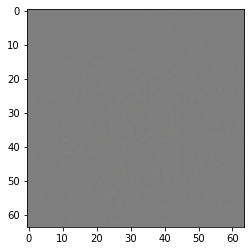

In [ ]:
generator = make_generator_model()

# generator random noise
noise = tf.random.normal([1, 100])

# generate an image and set training to False to ensure no training happens in the process
generated_image = generator(noise, training=False)

# convert the pixel values from [-1, 1] to [0, 1] for matplotlib compatibility.
plt.imshow((generated_image[0, :, :, :]*127.5 + 127.5) / 255.0)

### The Discriminator

The Discriminator is a CNN-based image classifier. Its task is to differentiate the real images from the fake ones. Hence, we are applying a taking a regular approach of using blocks of Convolutional layers. However, we are not MaxPooling because it is not recommended by commonly cited research in DCGANS ([NIPS 2016 Tutorial: Generative Adversarial Networks](https://arxiv.org/abs/1701.00160)). 
- We are also using the LeakyReLU activation function throughout. It performs better than ReLU because instead of zeroing out the negative neuron values, it instead scales them down to a small value. This allows the neurons to still be active in training and possibly get 'revived' at some epoch.
- We are also using Dropout to turn off random 30% of neurons to give a chance to other neurons. This prevents a small subset of neurons from becoming too powerful and thus overfitting the data. 
- Finally, we are not using an activation function on the last layer because we want the model to output negative values for fake images and positive for real ones.

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[64, 64, 4]))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

discriminator = make_discriminator_model()

## Loss functions and optimizers

In this section, we define loss functions and optimizers.


We will base our loss functions of cross-entropy. Cross-entropy is a loss function that calculates how 'suprising' it was to observe the predictions given the true distribution ([NIPS 2016 Tutorial: Generative Adversarial Networks](https://arxiv.org/abs/1701.00160)). For example, if we pass in 2 images (Real, Fake), their labels would be (1, 0). Now, let's say our Discriminator gives the following probabilities of images being real: (0.89, 0.1). This is the formula for binary cross-entropy: $H = -\frac{1}{N} \sum_{i=1}^N t_i \log{(p_i)} + (1 - t_i) \log{(1-p(y_i))}$, where t is the truth value (1 or 0), $p_i$ is the sigmoid probability, and $N$ is the number of points. Let's apply it to find the cross-entropy in our example:

1. $H_1 = 1*\log{(0.89)} + 0*\log{(0.11)} = -0.16812$
2. $H_2 = 1*\log{(0.1)} + 0*\log{(0.9)}= -3.322$
3. $H = -\frac{1}{N} * (H_1 + H_2) = -\frac{1}{2} * (-0.16812 + -3.322) = 1.75$

You can see that if we had predicted the Real image to be real with P=1, then our Cross-Entropy would be 0. And this is what we are aiming for: minimizing cross-entropy. However, with GANs, things a just a bit different. Let's see how.

In [ ]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Discriminator loss

Discriminators' job is to distinguish real from fake images. Since we are not using labels in our training process, we have to modify our loss function a bit. We will compare the Discriminator's predictions on real images to an array of 1s, and predictions on fake images to an array of 0s. We will then combine the two to return the total_loss.

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### Generator loss
The Generator's loss should quantify how well it can trick the Discriminator. It wants the Discriminator to classify Fake images as Real (probability of P(real) = 1). Therefore, we want to compute the cross-entropy for the Generator's loss by comparing Discriminator's predictions on fake images to an array of 1s.

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

The Discriminator and the generator optimizers are also different because we are training the two networks separately. We will use the Adam algorithm, which is essentially a version of Gradient Descent. We are *descending* because we want to *minimize* the loss function.

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### Save checkpoints
In case our training process gets interrupted, we define checkpoints that would save the model throughout the process.

In [ ]:
checkpoint_dir = '/content/drive/MyDrive/datasets/training_checkpoints/checkpoints_improv1'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Define the training loop

Now that we have our dataset, models, and loss & optimizers, it's time to see how they come together in the training process.

In [ ]:
# define constants. We will train the model for 50 epochs
EPOCHS = 200
noise_dim = 100
num_examples_to_generate = 16
seed = tf.random.normal([num_examples_to_generate, noise_dim])

The training loop begins with Generator receiving a random seed as input. That seed is used to produce an image. The Discriminator is then used to classify real images (drawn from the training set) from fake images (produced by the Generator). The loss is calculated for each of these models, and the gradients are used to update the Generator and Discriminator.

The training process is as follows :\
*for each epoch*:
1. Initialize the random input noise
2. Use this noise to generate fake images using Generator
3. Classify the images as real/fake using Discriminator
4. Calculate the loss functions for both Generator & Discriminator
5. Find the gradients
6. Apply the gradients to minimize loss functions, thus improving the performance

Note: the training process code below comes mostly from the [TF-GAN Tensorflow](https://www.tensorflow.org/tutorials/generative/dcgan) tutorial we mentioned above.

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    # 1. Initialize the random input noise
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # 2. generate fake images
        generated_images = generator(noise, training=True)
    
        # 3. get predicitons of Discriminator on the Real and Fake images
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        # 4. find the loss value for the generator and discriminator using loss functions above
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    # 5. find the gradients 
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    # 6. apply the gradients to optimize the performance
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [ ]:
def train(dataset, epochs):
    for epoch in range(epochs):
        start = time.time()

        for image_batch in dataset:
            train_step(image_batch)
            
        # Produce images for the GIF as you go
        display.clear_output(wait=True)
        generate_and_save_images(generator,
                             epoch + 1,
                             seed)

        # Save the model every 15 epochs
        if (epoch + 1) % 15 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)

        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))
        
    # Generate after the final epoch
    display.clear_output(wait=True)
    generate_and_save_images(generator,
                           epochs,
                           seed)

### Generate and save images

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      plt.subplot(4, 4, i+1)
      plt.imshow((predictions[i, :, :, :] * 127.5 + 127.5) / 255.0)
      plt.axis('off')

  plt.savefig('/content/drive/MyDrive/datasets/images/images_improv/image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

# Training

Finally, we can put our Data, Models, and Loss & Optimization functions together and train the model. We have trained several variations of Generator and Discriminator and will present you the one mentioned in code cells above. If you want to check out the failed models, go to Appendix A. 

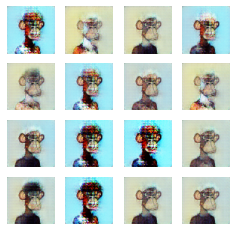

In [ ]:
train(train_dataset, EPOCHS)

In [ ]:
#checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
# save the models for future reuse
generator.save('/content/drive/MyDrive/datasets/models/generator_improv')
discriminator.save('/content/drive/MyDrive/datasets/models/discriminator_improv')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/datasets/models/generator_improv/assets
INFO:tensorflow:Assets written to: /content/drive/MyDrive/datasets/models/discriminator_improv/assets


In [ ]:
# LOAD PRETRAINED MODELS
from tensorflow.keras.models import load_model
generator = load_model('/content/drive/MyDrive/datasets/models/generator_improv')
discriminator = load_model('/content/drive/MyDrive/datasets/models/discriminator_improv')

## Create a GIF

In this section, we are going to create a GIF showing the generator's training progress over the 200 Epochs. We borrowed the code from the [TF-GAN tensorflow tutorial](https://www.tensorflow.org/tutorials/generative/dcgan) and modified it for our needs

In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
    return PIL.Image.open('/content/drive/MyDrive/datasets/images/images_improv/image_at_epoch_{:04d}.png'.format(epoch_no))

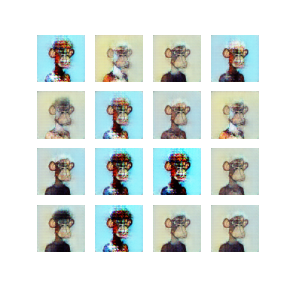

In [ ]:
display_image(EPOCHS)

In [ ]:
anim_file = 'dcgan_improv.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('/content/drive/MyDrive/datasets/images/images_improv/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)


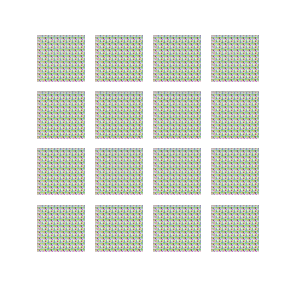

In [ ]:
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

The training process was exciting as we could observe the output at every epoch. For the first ten epochs, the output looked like random noise. For the next 100 epochs, the Generator extracted common patterns and shapes. However, the background color was still varying, and it easily gave away the fake images because a real image's background is constant. However, at around epoch 129, the background color was finally constant. We also observed an emergence of what we called the 'Apius-Regularius', or the "Regular Ape." It looked like an Ape stripped away of all privileges of tribe life and merch. He/she was plain brown in color, did not have a shirt or a hat or anything at all. This was quite a discovery, and we are happy to present it to you:


Text(0.5, 1.0, 'Specie: Apius Regularius')

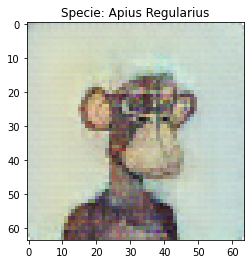

In [ ]:
apius_regularius = generator(seed, training=False)

plt.imshow((apius_regularius[11, :, :, :]*127.5 + 127.5) / 255.0)
plt.title("Specie: Apius Regularius")

Apius Regularius is standing proudly in the face of the uncertain future. His well-defined posture and ears will serve as a great gene to pass on to his descendants. In other words, the original apes all had the same posture and ears, as well as a constant background color. The Generator quickly picked up on it, and you will see that most of the generated images also have a static posture and ears.

Let's see what the cruel world and evolution prepared for the rest of the species.

# Evaluation

In this section, we will evaluate the Generator's performance using quantitative and qualitative methods.

### Inception Score
Firstly, let's classify our GAN quantitatively. Inception score (IS) is a popular metric for quantifying GANs performance. It combined two key features of generated images distribution:
1. Certainty in label classifications of individual images. 
2. Variety in the overall distribution of the images.

We want the Generator to create distinct images but also to have a variety in the distribution. 

To find IS, we first need to find class probabilities for each generated image using the Inception V3 model by Google. In or case, each image would get an output like this $(p(y_i), p(x_i), p(z_i) ...)$. Here, $p$ corresponds to a class probability, such as P(ape) = 0.8, P(horse) = 0.19, P(ship) = 0.01 (Inception V3 was trained on various classes, so we will have unrelated labels too). The ideal situation is when our model is 100% certain that it's an ape. However, the Inception V3 model includes only 1000 classes, and Bored Apes is not one of them. This is one of the drawbacks of IS.

Secondly, we want to quantify the variety. We can do it by looking at the distribution of marginal probabilities across the entire set of generated images. Ideally, we want a uniform distribution of generated classes, which means that our GAN has variety. However, it seems like this step is not applicable either because we want to generate apes and only apes. However, we do want to generate different-looking apes. Perhaps there is another way to quantify this, but this is outside the scope of this notebook. We will now move on to a qualitative evaluation of our GAN.

If you want to read more about the inception score, these resources provide a gentle introduction: [[1]](https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a), [[2]](https://machinelearningmastery.com/how-to-implement-the-inception-score-from-scratch-for-evaluating-generated-images/)

### Recall & Precision

We will also use traditional evaluation metrics to quantify the performance.

First, we'll find Recall the proportion of Fake images we detected as Fake by the Discriminator. For that, we take the proportion of fake images classified as real and divide it by the total number of images. 

Below, you can see the inverse of that -> how many fake images were classified as 'real' by the Discriminator. That number is 0.45%. Recall is equal to 100% - 0.45% = 99.55%. That's an extremely high value. This means that our Generator was not successful at tricking the Discriminator into believing that fake images are real. Ideally, we would aim for a recall of 0%, which would mean that our Generator is 100% successful at tricking. However, it may also indicate that we just have a poor quality Discriminator. 

In [ ]:
n = 9999
noise = tf.random.normal([n, 100])
generated_images = generator(noise, training=False)

fake_preds = discriminator(generated_images, training=False)
fake_preds = np.array(fake_preds)
fake_classes = np.where(fake_preds < 0, 0, 1)
proportion_decepted = np.sum(fake_classes)/n
print(f'Generator has tricked Discriminator that {np.round(proportion_decepted*100, 2)}% images are real')

Generator has tricked Discriminator that 0.45% images are real


We also hypothesized that maybe in an attempt to find fake images, the Discriminator unlearned to classify real images. We tested if it's true with precision: proportion of real images classified as real. We can see that the precision is 95.84%, indicating that the Discriminator is still good at identifying the real images.

In [ ]:
real_preds = discriminator(train_images, training=False)
real_preds = np.array(real_preds)
real_classes = np.where(real_preds < 0, 0, 1)
proportion_detected = np.sum(real_classes)/train_images.shape[0]
print(f'Discriminator has classified {np.round(proportion_detected*100, 2)}% images as being real from the real dataset')

Discriminator has classified 95.84% images as being real from the real dataset


Overall, we can conclude that Generator didn't do a good job at tricking the Discriminator. This is likely because the Discriminator was more powerful (it was overall more flexible with its layers and functions) or because the dataset is hard to replicate.

You may also check out Appendix A: Neglected Apes & Failed Models to see what happens when the Discriminator is overpowered.

### Qualititative Evaluation

Below, we plotted five generated apes and five randomly selected real apes. To perform a subjective evaluation of GANs, we would usually survey people about which image is real and which is fake. However, in this scenario, we do acknowledge that our generated apes look obviously 'fake' in contrast to the real ones. In particular:
1. The background color has a slight gradient to it, even though it's mostly constant. The background also doesn't look smooth and has some noise.
2. There is a lot of noise across the images, especially in the cerebral and eyes area: Apes #2 and #5 look like the surgeon forgot to close the skull after an open-head surgery.

On the other side, we also have things to be proud of:
1. The Generator picked up on the constant background color and background colors
2. The posture and ears are well-defined
3. The mouth area also has sufficient details
4. Overall, the images do look like Bored Apes.

Overall, our GAN did a decent job at generating Bored Apes. The model picked up on the constant features present across all original apes, like background color, posture, and ears. It struggled to generate patterns for the top of the head because the original apes had a lot of variability in that area, such as accessories, expressions, hats, glasses, special effects, etc.

We also want to give our apes names. Here is our subjective labeling for the five apes below:
1. A classical piano player with buttoned-up shirt
2. An intellectual listening to the piano concert
3. A real psycho
4. Apius Regularius in a plain gray sweater
5. General Ape retired from military in his white costumer and medals

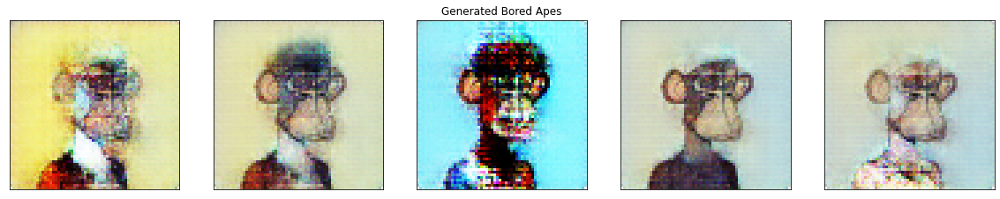

In [ ]:
n = 5
noise = tf.random.normal([n, 100])
generated_image = generator(noise, training=False)

#plt.imshow((generated_image[15, :, :, :]*127.5 + 127.5) / 255.0)
#print(discriminator(generated_image, training=False))
plot_images(n, generated_image, title='Generated Bored Apes')

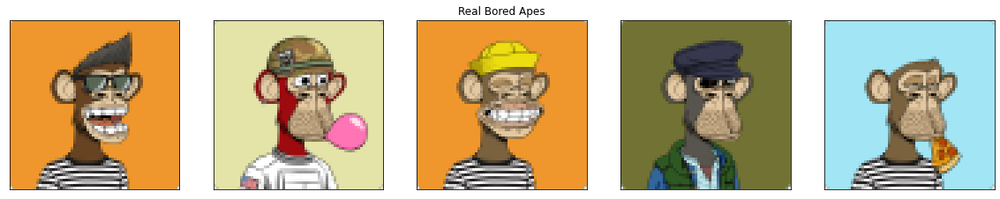

In [ ]:
plot_images(n, train_images, random=True, title='Real Bored Apes')

In [ ]:
def gen_save_new_images(n, generator):
  '''Generates n images and uploads them to the chosen path'''
  noise = tf.random.normal([n, 100])
  predictions = generator(noise, training=False)

  for i in range(predictions.shape[0]):
      plt.imshow((predictions[i, :, :, :] * 127.5 + 127.5) / 255.0)
      plt.axis('off')
      plt.savefig('/content/drive/MyDrive/datasets/images/images_individual/image_{:04d}.png'.format(i))

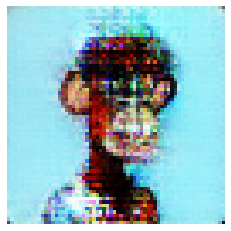

In [ ]:
gen_save_new_images(100, generator)

If you are craving to see **more generated apes**, we are inviting you to check out our gallery by following [this link](https://drive.google.com/drive/folders/1R8Vzbgdmmx3-rPedEVek0qqgEuCJltbk?usp=sharing)

# Conclusion

In this notebook, we generated fake Bored Apes using DCGANs trained on the Bored Apes Yacht Club NFT dataset. We saw that while the generated images resemble apes quite well, it is easy to distinguish the fake from the real ones.

The next possible steps are:
- Improving the DCGAN
- Playing with DCGAN arithmetics to add/subtract accessories from the Apes
- Creating an interactive experience with text-to-image or a drawing canvas. The DCGAN would generate an Ape based on the text or drawing input.

### References

[1] Brownlee, J. (2019, August 27). How to Implement the Inception Score (IS) for Evaluating GANs. Machine Learning Mastery. https://machinelearningmastery.com/how-to-implement-the-inception-score-from-scratch-for-evaluating-generated-images/

[2] Deep Convolutional Generative Adversarial Network | TensorFlow Core. (n.d.). TensorFlow. Retrieved December 14, 2021, from https://www.tensorflow.org/tutorials/generative/dcgan

[3] Goodfellow, I. (2017). NIPS 2016 Tutorial: Generative Adversarial Networks. ArXiv:1701.00160 [Cs]. http://arxiv.org/abs/1701.00160

[4] Mack, D. (2019, March 7). A simple explanation of the Inception Score. Octavian. https://medium.com/octavian-ai/a-simple-explanation-of-the-inception-score-372dff6a8c7a

[5] Radford, A., Metz, L., & Chintala, S. (2016). Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks. ArXiv:1511.06434 [Cs]. http://arxiv.org/abs/1511.06434


# Appendix A: Neglected Apes & Failed Models

## Attempt 1 - Transfer Learning

The Discriminator is a CNN-based image classifier. Its task is to differentiate the real images from the fake ones. Since it's a CNN classification task, we decided to try and apply Transfer Learning from VGG16 to speed up the training and make a robust discriminator. The idea is that we take the first many layers of the pre-trained VGG16 model, which are trained to recognize various shapes and patterns. However, we exclude the 'top' part, which corresponds to dataset-specific patterns. Then, we add a few trainable layers on top of the base model so that our model can also specialize in our dataset. Finally, we have a single Dense layer with a sigmoid activation function & binary cross-entropy loss function because we are facing a binary classification problem. The usage of Transfer Learning is purely experimental, and we are excited to see how it works out. 

In [ ]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*512, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((8, 8,512)))
    assert model.output_shape == (None, 8, 8, 512)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(256, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 8, 8, 256)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 3)

    return model

generator = make_generator_model()

In [ ]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model

def make_discriminator_model():
    #extract features from pretrained model mobile-net
    base_model = VGG16(weights='imagenet',
                            include_top=False, input_shape=(64, 64, 3))
    base_model.trainable = False
    x = base_model.output
    x = layers.Conv2D(64, (3, 3), strides=(1, 1), padding='same')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1)(x)
    
    model = Model(inputs=base_model.input, outputs=x)

    return model

discriminator = make_discriminator_model()

### Loading the model
Finally, we call the `train()` method above to train the Generator and Discriminator simultaniously. To improve the results and prevent our laptop from melting a hole in the desk, we will train our model on an AWS EC2 instance. You can find the training file here: https://github.com/nikita-kotsehub/DCGAN_training_package

To download the pre-processed data, follow these steps inside the repo:
1. Install the Google Drive package to easily download files from Google Drive: `pip install gdown`
2. Download the [data](https://drive.google.com/file/d/1DwQkMDHC1R9E2heYqFPjBo6B443iNSP3/view?usp=sharing) using file id: `wget --id 1DwQkMDHC1R9E2heYqFPjBo6B443iNSP3`

After 50 epochs and 25 hours of training, here is what we got.

In [ ]:
from tensorflow.keras.models import load_model
generator = load_model('generator_1')
discriminator = load_model('discriminator_1')

We can see that the Generator did not learn distinguishable patterns and has a lot of noise, even after 50 epochs. We hypothesize that it's because our Discriminator was too powerful at distinguishing the real vs. fake images, and thus the Generator just attempted random improvements in a desperate attempt to trick the Discriminator. However, without getting any improvements and 'descending' the gradient, it never really learned anything.

tf.Tensor([[-0.8373951]], shape=(1, 1), dtype=float32)
tf.Tensor([[2.0546288]], shape=(1, 1), dtype=float32)


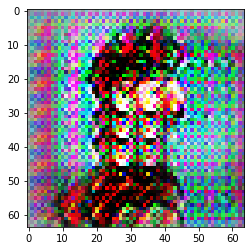

In [ ]:
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

plt.imshow((generated_image[0, :, :, :]*127.5 + 127.5) / 255.0)
print(discriminator(generated_image, training=False))
print(discriminator(np.array([train_images[7]]), training=False))


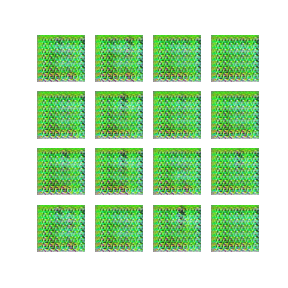

In [ ]:
import tensorflow_docs.vis.embed as embed
anim_file_transfer = '/content/drive/MyDrive/datasets/gifs/dcgan_transfer.gif'
embed.embed_file(anim_file_transfer)


# Attempt 2: Light-weighted Discriminator

In this attempt, we just used a more lightweight Discriminator proposed by the TF-GAN Tensorflow tutorial for MNIST images. The model provided good results after 100 epochs. However, we were curious what would happen if we improved the Discriminator, and we presented the improved version in this notebook.


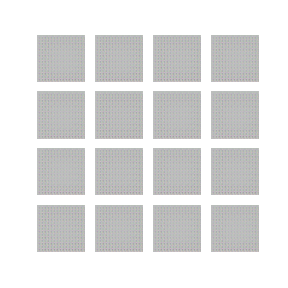

In [ ]:
anim_file_standard = '/content/drive/MyDrive/datasets/gifs/dcgan_standard.gif'
embed.embed_file(anim_file_standard)

In [ ]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(8*8*512, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((8, 8,512)))
    assert model.output_shape == (None, 8, 8, 512)  # Note: None is the batch size

    model.add(layers.Conv2DTranspose(256, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 8, 8, 256)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 16, 16, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 32, 32, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(4, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 64, 64, 4)

    return model

generator = make_generator_model()

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[64, 64, 4]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

discriminator = make_discriminator_model()